# Project Phase 1 + 2 


# Imports

In [ ]:
%pip install mlxtend --upgrade
import pandas as pd
import numpy as np
from sklearn import preprocessing
import math
import seaborn as sn
import matplotlib.pyplot as plt
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import fpgrowth

     |████████████████████████████████| 1.3 MB 4.4 MB/s 
  Attempting uninstall: mlxtend
    Found existing installation: mlxtend 0.14.0
    Uninstalling mlxtend-0.14.0:
      Successfully uninstalled mlxtend-0.14.0


# Preprocessing

In [ ]:
# Load dataset into data frame
dataset_df = pd.read_csv('https://drive.google.com/uc?export=download&id=16D8GBCj5iOn3GGo_oWNmw1K3_BFS0t_7')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (0,2,6) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
# Dataset Overview
dataset_df.head(5)

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location
0,I192068249,2647,Other,THREATS TO DO BODILY HARM,B2,280,NaN,8/28/15 10:20,2015,8,Friday,10,WASHINGTON ST,42.330119,-71.084251,"(42.33011862, -71.08425106)"
1,I192061894,1106,Confidence Games,FRAUD - CREDIT CARD / ATM FRAUD,C11,356,NaN,8/20/15 0:00,2015,8,Thursday,0,CHARLES ST,42.300605,-71.061268,"(42.30060543, -71.06126785)"
2,I192038828,1107,Fraud,FRAUD - IMPERSONATION,A1,172,NaN,11/2/15 12:24,2015,11,Monday,12,ALBANY ST,42.334288,-71.072395,"(42.33428841, -71.07239518)"
3,I192008877,1107,Fraud,FRAUD - IMPERSONATION,E18,525,NaN,7/31/15 10:00,2015,7,Friday,10,WINGATE RD,42.237009,-71.129566,"(42.23700950, -71.12956606)"
4,I182090828,1102,Fraud,FRAUD - FALSE PRETENSE / SCHEME,D4,159,NaN,12/1/15 12:00,2015,12,Tuesday,12,UPTON ST,42.342432,-71.072258,"(42.34243222, -71.07225766)"


In [ ]:
# Initial data types
dataset_df.dtypes

INCIDENT_NUMBER         object
OFFENSE_CODE             int64
OFFENSE_CODE_GROUP      object
OFFENSE_DESCRIPTION     object
DISTRICT                object
REPORTING_AREA          object
SHOOTING                object
OCCURRED_ON_DATE        object
YEAR                     int64
MONTH                    int64
DAY_OF_WEEK             object
HOUR                     int64
STREET                  object
Lat                    float64
Long                   float64
Location                object
dtype: object

## Suitable Data Types
|Attribute|Type|
|-|-|
|INCIDENT_NUMBER|Integer|
|OFFENSE_CODE|Integer|
|OFFENSE_CODE_GROUP|String|
|OFFENSE_DESCRIPTION|String|
|DISTRICT|String|
|REPORTING_AREA|Integer|
|SHOOTING|Boolean|
|OCCURRED_ON_DATE|DateTime|
|YEAR|Integer|
|MONTH|Integer|
|DAY_OF_WEEK|Integer|
|HOUR|Integer|
|STREET|String|
|Lat|Float|
|Long|Float|
|Location|Float|

## Preprocessing Codes

In [ ]:
### INCIDENT_NUMBER Preprocessing ###
#   Remove Leading "|" if present
#     Use .replace() to replace "|" with ""
#   Convert to int

dataset_df['INCIDENT_NUMBER'] = dataset_df['INCIDENT_NUMBER'].astype(str)
dataset_df['INCIDENT_NUMBER'] = dataset_df['INCIDENT_NUMBER'].str.replace(r'\D', '')
dataset_df['INCIDENT_NUMBER'] = dataset_df['INCIDENT_NUMBER'].astype('int')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: The default value of regex will change from True to False in a future version.
  import sys


In [ ]:
### REPORTING_AREA Preprocessing ###
# (Missing values as '-1')
#   Convert to int

dataset_df['REPORTING_AREA'] = dataset_df['REPORTING_AREA'].astype(str)
dataset_df['REPORTING_AREA'] = dataset_df['REPORTING_AREA'].str.replace(' ', '-1')
dataset_df['REPORTING_AREA'] = dataset_df['REPORTING_AREA'].replace({'0': '-1'})
dataset_df['REPORTING_AREA'] = dataset_df['REPORTING_AREA'].astype('int')

In [ ]:
### SHOOTING Preprocessing ###
#   Convert to boolean
#     Replace "Y" with "1"
#     Replace Nan with "0"

dataset_df['SHOOTING'] = dataset_df['SHOOTING'].fillna('0')
dataset_df['SHOOTING'] = dataset_df['SHOOTING'].astype(str)
dataset_df['SHOOTING'] = dataset_df['SHOOTING'].replace({'1':True, 'Y': True, '0': False})
dataset_df['SHOOTING'] = dataset_df['SHOOTING'].astype('boolean')

In [ ]:
### OCCURED_ON_DATE Preprocessing ###
#   Convert to DateTime

dataset_df['OCCURRED_ON_DATE'] = dataset_df['OCCURRED_ON_DATE'].astype('datetime64[ns]')

In [ ]:
### Lat & Long Preprocessing ###
# (Missing Values as 0)

# Lat
#   Nan -> 0
dataset_df['Lat'] = dataset_df['Lat'].fillna(0)
#   -1  -> 0
dataset_df['Lat'] = dataset_df['Lat'].replace({-1: 0})

# Long
#   Nan -> 0
dataset_df['Long'] = dataset_df['Long'].fillna(0)
#   -1  -> 0
dataset_df['Long'] = dataset_df['Long'].replace({-1: 0})

In [ ]:
### OFFENSE_CODE_GROUP Preprocessing ###

## Extract unique code_groups from dataset
dataset_df['OFFENSE_CODE_GROUP'] = dataset_df['OFFENSE_CODE_GROUP'].astype(str)
unq_ocg = dataset_df['OFFENSE_CODE_GROUP'].unique()

dataset_df['OFFENSE_CODE_GROUP'] = dataset_df['OFFENSE_CODE_GROUP'].replace('INVESTIGATE PERSON', 'Investigate Person')

## Encode OFFENSE_CODE_GROUP

# Extract Mapping
group_label_index = {} # IMPORTANT
group_index_label = {} # IMPORTANT
i = 0
for g in unq_ocg:
  if g == 'nan':
    continue
  group_label_index[g] = i
  group_index_label[i] = g
  i += 1

group_label_index['nan'] = -1
group_index_label[-1] = 'nan'

# Apply Mapping
dataset_df['OFFENSE_CODE_GROUP'] = dataset_df['OFFENSE_CODE_GROUP'].replace(group_label_index)

# Update Uniqe
unq_ocg_index = dataset_df['OFFENSE_CODE_GROUP'].unique()

In [ ]:
### OFFENSE_DESCRIPTION Preprocessing ###

## Extract unique code_groups from dataset
dataset_df['OFFENSE_DESCRIPTION'] = dataset_df['OFFENSE_DESCRIPTION'].astype(str)
unq_od = dataset_df['OFFENSE_DESCRIPTION'].unique()

## Encode OFFENSE_DESCRIPTION

# Extract Mapping
desc_label_index = {} # IMPORTANT
desc_index_label = {} # IMPORTANT
i = 0
for d in unq_od:
  if d == 'nan':
    continue
  desc_label_index[d] = i
  desc_index_label[i] = d
  i += 1

desc_label_index['nan'] = -1
desc_index_label[-1] = 'nan'

# Apply Mapping
dataset_df['OFFENSE_DESCRIPTION'] = dataset_df['OFFENSE_DESCRIPTION'].replace(desc_label_index)

# Update Unique
unq_od_index = dataset_df['OFFENSE_DESCRIPTION'].unique()

In [ ]:
### DISTRICT Preprocessing ###

## Extract unique district_area from dataset
dataset_df['DISTRICT'] = dataset_df['DISTRICT'].astype(str)
unq_ds = dataset_df['DISTRICT'].unique()

## Encode OFFENSE_DESCRIPTION

# Extract Mapping
ds_label_index = {} # IMPORTANT
ds_index_label = {} # IMPORTANT
i = 0
for d in unq_ds:
  if d == 'nan':
    continue
  ds_label_index[d] = i
  ds_index_label[i] = d
  i += 1

ds_label_index['nan'] = -1
ds_index_label[-1] = 'nan'

# Apply Mapping
dataset_df['DISTRICT'] = dataset_df['DISTRICT'].replace(ds_label_index)

# Update Unique
unq_ds_index = dataset_df['DISTRICT'].unique()

In [ ]:
### STREET Preprocessing ###

## Extract unique district_area from dataset
dataset_df['STREET'] = dataset_df['STREET'].astype(str)
unq_st = dataset_df['STREET'].unique()

## Encode OFFENSE_DESCRIPTION

# Extract Mapping
st_label_index = {} # IMPORTANT
st_index_label = {} # IMPORTANT
i = 0
for s in unq_st:
  if s == 'nan':
    continue
  st_label_index[s] = i
  st_index_label[i] = s
  i += 1

st_label_index['nan'] = -1
st_index_label[-1] = 'nan'

# Apply Mapping
dataset_df['STREET'] = dataset_df['STREET'].replace(st_label_index)

# Update Unique
unq_st_index = dataset_df['STREET'].unique()

In [ ]:
### DAY_OF_WEEK Preprocessing ###

## Extract unique district_area from dataset
dataset_df['DAY_OF_WEEK'] = dataset_df['DAY_OF_WEEK'].astype(str)
unq_dw = dataset_df['DAY_OF_WEEK'].unique()
unq_dw

## Encode OFFENSE_DESCRIPTION

# Extract Mapping
dw_label_index = {} # IMPORTANT
dw_index_label = {} # IMPORTANT
i = 0
for d in unq_dw:
  if d == 'nan':
    continue
  dw_label_index[d] = i
  dw_index_label[i] = d
  i += 1

dw_label_index['nan'] = -1
dw_index_label[-1] = 'nan'

# Apply Mapping
dataset_df['DAY_OF_WEEK'] = dataset_df['DAY_OF_WEEK'].replace(dw_label_index)

## Find & Handle Missing Values

In [ ]:
### INCIDENT_NUMBER Missing Values ###
dataset_df['INCIDENT_NUMBER'].isnull().sum()

0

In [ ]:
### OFFENSE_CODE Missing Values ###
dataset_df['OFFENSE_CODE'].isnull().sum()

0

In [ ]:
### OFFENSE_CODE_GROUP Missing Values ###
group_nans = dataset_df[dataset_df['OFFENSE_CODE_GROUP'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1):', group_nans)

# Create Group_Code Map (1 to Many Mapping)
group_code_map = {}
for u in unq_ocg_index:
  if u == -1:
    continue
  temp_df = dataset_df[dataset_df['OFFENSE_CODE_GROUP'] == u]['OFFENSE_CODE']
  group_code_map[u] = temp_df.unique()

# Create Code_Group Map (1 to 1 Mapping)
code_group_map = {}
for g in group_code_map:
  for c in group_code_map[g]:
    if c not in code_group_map:
      code_group_map[c] = g

# Replace Nan values using Code_Group
for c in code_group_map:
  dataset_df.loc[(dataset_df['OFFENSE_CODE_GROUP'] == -1) & (dataset_df['OFFENSE_CODE'] == c), 'OFFENSE_CODE_GROUP'] = code_group_map[c]

group_nans = dataset_df[dataset_df['OFFENSE_CODE_GROUP'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1) after replacement by code:', group_nans)

# Create Group_Desc Map (1 to Many Mapping)
group_desc_map = {}
for u in unq_ocg_index:
  if u == -1:
    continue
  temp_df = dataset_df[dataset_df['OFFENSE_CODE_GROUP'] == u]['OFFENSE_DESCRIPTION']
  group_desc_map[u] = temp_df.unique()

# Create Desc_Group Map (1 to 1 Mapping)
desc_group_map = {}
for g in group_desc_map:
  for d in group_desc_map[g]:
    if d not in desc_group_map:
      desc_group_map[d] = g

# Replace Nan values using Desc_Group
for d in desc_group_map:
  dataset_df.loc[(dataset_df['OFFENSE_CODE_GROUP'] == -1) & (dataset_df['OFFENSE_DESCRIPTION'] == c), 'OFFENSE_CODE_GROUP'] = desc_group_map[d]

group_nans = dataset_df[dataset_df['OFFENSE_CODE_GROUP'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1) after replacement by desc:', group_nans)

No. of missing values (-1): 214370
No. of missing values (-1) after replacement by code: 10564
No. of missing values (-1) after replacement by desc: 10564


In [ ]:
### OFFENSE_DESCRIPTION Missing Values ###
desc_nans = dataset_df[dataset_df['OFFENSE_DESCRIPTION'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1):', desc_nans)

No. of missing values (-1): 0


In [ ]:
### DISTRICT Missing Values ###
ds_nans = dataset_df[dataset_df['DISTRICT'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1):', ds_nans)

# Find Unique Areas
area_unq_index = dataset_df['REPORTING_AREA'].unique()

# Create Avg Lat & Long Maps for District-Area pairs
ds_area_avg_lat_map = {}
ds_area_avg_long_map = {}
for u in unq_ds_index:
  if u == -1:
    continue
  temp_df = dataset_df[dataset_df['DISTRICT'] == u]
  for a in area_unq_index:
    if a == -1:
      continue
    temp_df_2 = temp_df[temp_df['REPORTING_AREA'] == a]
    ds_area_avg_lat_map[(u, a)] = temp_df_2[temp_df_2['Lat'] != 0]['Lat'].mean()
    ds_area_avg_long_map[(u, a)] = temp_df_2[temp_df_2['Long'] != 0]['Long'].mean()

# Identify & Remove Nan values
temp_len = len(ds_area_avg_lat_map)
lat_nan_keys = []
long_nan_keys = []
for k in ds_area_avg_lat_map:
  if math.isnan(ds_area_avg_lat_map[k]):
    lat_nan_keys.append(k)
  if math.isnan(ds_area_avg_long_map[k]):
    long_nan_keys.append(k)

for k in lat_nan_keys:
  del ds_area_avg_lat_map[k]

for k in long_nan_keys:
  del ds_area_avg_long_map[k]

# Extract Area & Lat & Long for nan Districts
ds_nan_df = dataset_df[dataset_df['DISTRICT'] == -1]
ds_nan_area = ds_nan_df['REPORTING_AREA']
ds_nan_lat = ds_nan_df['Lat']
ds_nan_long = ds_nan_df['Long']

# Replace nan District with shortest Area & Lat & Long distance
for i in ds_nan_df.index:
  min_diff = None
  min_d = None
  for d in unq_ds_index:
    if ((d, ds_nan_area[i]) in ds_area_avg_lat_map) and ((d, ds_nan_area[i]) in ds_area_avg_long_map):
      current_diff_lat = abs(abs(ds_nan_lat[i]) - abs(ds_area_avg_lat_map[(d, ds_nan_area[i])]))
      current_diff_long = abs(abs(ds_nan_long[i]) - abs(ds_area_avg_long_map[(d, ds_nan_area[i])]))
      current_diff = current_diff_lat + current_diff_long
      if min_diff == None:
        min_diff = current_diff
        min_d = d
      elif current_diff < min_diff:
        min_diff = current_diff
        min_d = d
  
  if min_d != None:
    dataset_df.loc[i, 'DISTRICT'] = min_d

ds_nans = dataset_df[dataset_df['DISTRICT'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1) after replacement with (Area, Lat & Long):', ds_nans)

No. of missing values (-1): 3421
No. of missing values (-1) after replacement with (Area, Lat & Long): 2435


In [ ]:
### STREET Missing Values ###
st_nans = dataset_df[dataset_df['STREET'] == -1]['INCIDENT_NUMBER'].count()
print('No. of missing values (-1):', st_nans)

print('unq_std_index len:', unq_st_index.shape[0])

########### DONT RUN THIS -> TAKES TOO MUCH TIME -> APPROACH FAILED ###########
# # Create Avg Lat & Long Maps for District-Street pairs
# ds_st_avg_lat_map = {}
# ds_st_avg_long_map = {}
# for u in unq_st_index:
#   if u == -1:
#     continue
#   temp_df = dataset_df[dataset_df['STREET'] == u]
#   for d in unq_ds_index:
#     if d == -1:
#       continue
#     temp_df_2 = temp_df[temp_df['DISTRICT'] == d]
#     ds_st_avg_lat_map[(d, u)] = temp_df_2[temp_df_2['Lat'] != 0]['Lat'].mean()
#     ds_st_avg_long_map[(d, u)] = temp_df_2[temp_df_2['Long'] != 0]['Long'].mean()
    
# # Identify & Remove Nan values
# temp_len = len(ds_st_avg_lat_map)
# lat_nan_keys = []
# long_nan_keys = []
# for k in ds_st_avg_lat_map:
#   if math.isnan(ds_st_avg_lat_map[k]):
#     lat_nan_keys.append(k)
#   if math.isnan(ds_st_avg_long_map[k]):
#     long_nan_keys.append(k)

# for k in lat_nan_keys:
#   del ds_st_avg_lat_map[k]

# for k in long_nan_keys:
#   del ds_st_avg_long_map[k]

# # Extract District & Area & Lat & Long for nan Streets
# st_nan_df = dataset_df[dataset_df['STREET'] == -1]
# st_nan_df = st_nan_df[st_nan_df['DISTRICT'] != -1]
# st_nan_df = st_nan_df[st_nan_df['Lat'] != 0]
# st_nan_ds = st_nan_df['DISTRICT']
# st_nan_lat = st_nan_df['Lat']
# st_nan_long = st_nan_df['Long']

# # Replace nan District with shortest Area & Lat & Long distance
# for i in st_nan_df.index:
#   min_diff = None
#   min_s = None
#   for s in unq_st_index:
#     if ((st_nan_ds[i], s) in ds_st_avg_lat_map) and ((st_nan_ds[i], s) in ds_st_avg_long_map):
#       current_diff_lat = abs(abs(st_nan_lat[i]) - abs(ds_st_avg_lat_map[(st_nan_ds[i], s)]))
#       current_diff_long = abs(abs(st_nan_long[i]) - abs(ds_st_avg_long_map[(st_nan_ds[i], s)]))
#       current_diff = current_diff_lat + current_diff_long
#       if min_diff == None:
#         min_diff = current_diff
#         min_s = s
#       elif current_diff < min_diff:
#         min_diff = current_diff
#         min_s = s
  
#   if min_s != None:
#     dataset_df.loc[i, 'STREET'] = min_s

# st_nans = dataset_df[dataset_df['STREET'] == -1]['INCIDENT_NUMBER'].count()
# print('No. of missing values (-1) after replacement with (District, Lat & Long):', st_nans)

No. of missing values (-1): 11886
unq_std_index len: 13544


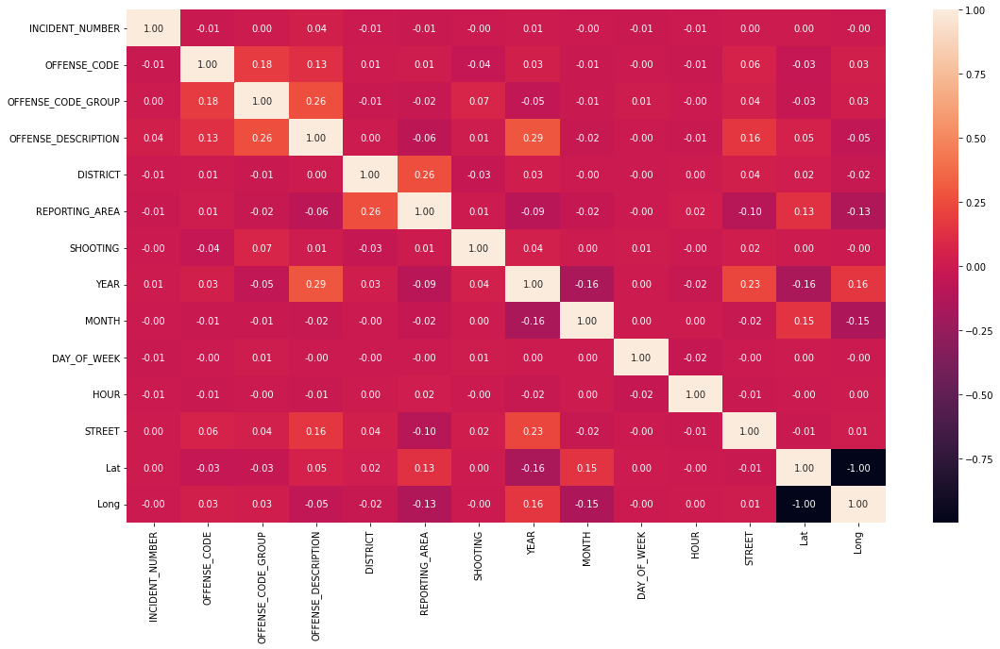

In [ ]:
# Correlation between attributes.

corrMat = dataset_df.corr()
corrMat.style.background_gradient(cmap='coolwarm')
plt.figure(figsize=(18,10))
sn.heatmap(dataset_df.corr(), annot = True, fmt = '.2f')
plt.show()

In [ ]:
## Most frequently occuring incident

# Most frequently occuring incident according to Offense code group
mf_ocg1 = dataset_df.mode()['OFFENSE_CODE_GROUP'][0]
mf_ocg = group_index_label[mf_ocg1]

print("Most frequently occuring incident is: ", mf_ocg)

Most frequently occuring incident is:  Motor Vehicle Accident Response


In [ ]:
## District wise analysis based on number of incidents

dis = dataset_df.groupby('DISTRICT').size()
# print(dis)
dis_inc = {}

# for i in range(len(dis)):
#   dist = ds_index_label[i]
#   if dist == 'nan':
#     continue
#   dis_inc[dist] = dis[i]

# # print(dis_inc)

# districts = list(dis_inc.keys())
# incidents = list(dis_inc.values())
# plt.figure(figsize=(18,8))
# plt.bar(range(len(dis_inc)), incidents, tick_label=districts)
# plt.xlabel("Districts", fontsize=15)
# plt.ylabel("No.of Incidents", fontsize=15)
# plt.show()


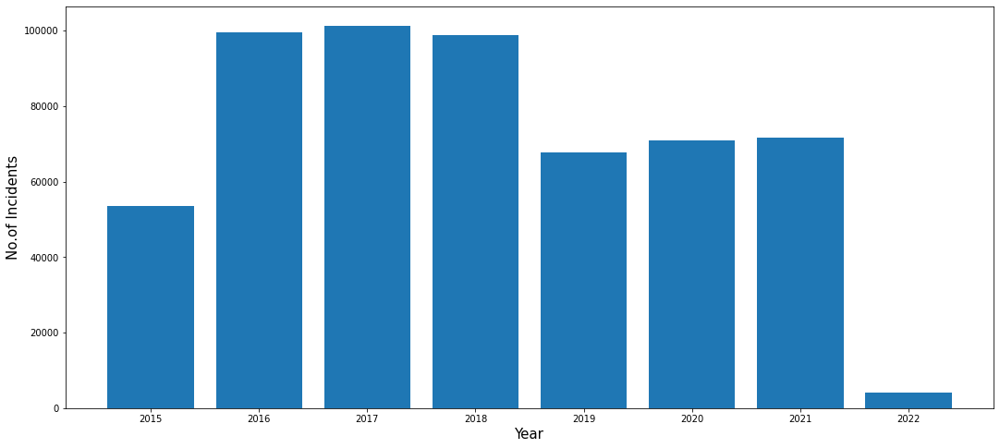

In [ ]:
year = dataset_df.groupby('YEAR').size()
year_list = [2015,2016,2017,2018,2019,2020,2021,2022]

year_inc = {}

i = 0
y = 2015
for i in range(len(year)):
  year_inc[year_list[i]] = year[y]
  i+=1
  y+=1

years = list(year_inc.keys())
no_of_incidents = list(year_inc.values())
plt.figure(figsize=(18,8))
plt.bar(range(len(year_inc)), no_of_incidents, tick_label=years)
plt.xlabel("Year", fontsize=15)
plt.ylabel("No.of Incidents", fontsize=15)
plt.show()



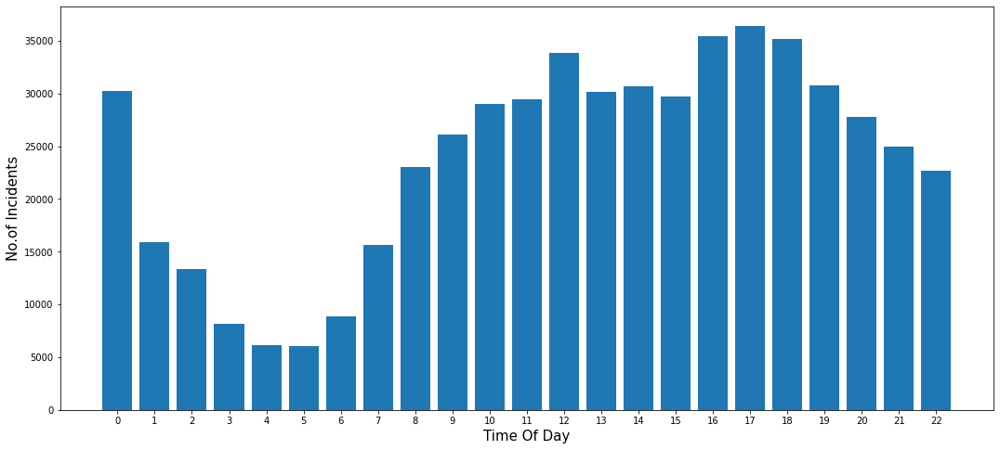

In [ ]:
hour = dataset_df.groupby('HOUR').size()
hour_list = []
for i in range(23):
  hour_list.append(i)

hour_inc = {}
for i in range(len(hour_list)):
  hour_inc[i] = hour[i]

hours = list(hour_inc.keys())
incidents_count = list(hour_inc.values())
plt.figure(figsize=(18,8))
plt.bar(range(len(hour_inc)), incidents_count, tick_label=hours)
plt.xlabel("Time Of Day", fontsize=15)
plt.ylabel("No.of Incidents", fontsize=15)
plt.show()


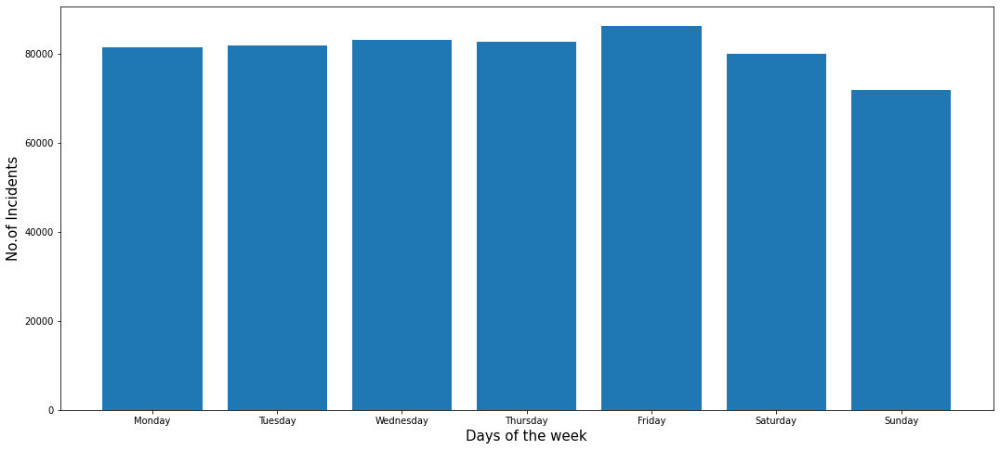

In [ ]:
## Analysis of Incidents with Days of the week

counts_by_days = dataset_df.groupby('DAY_OF_WEEK').size()
# print(counts_by_days)
counts = {}

for i in range(len(counts_by_days)):
  day = dw_index_label[i]
  counts[day] = counts_by_days[i]

# print(counts)

rearrange = {}
rearrange['Monday'] = counts['Monday']
rearrange['Tuesday'] = counts['Tuesday']
rearrange['Wednesday'] = counts['Wednesday']
rearrange['Thursday'] = counts['Thursday']
rearrange['Friday'] = counts['Friday']
rearrange['Saturday'] = counts['Saturday']
rearrange['Sunday'] = counts['Sunday']

# print(rearrange)

days = list(rearrange.keys())
num = list(rearrange.values())
plt.figure(figsize=(18,8))
plt.bar(range(len(rearrange)), num, tick_label=days)
plt.xlabel("Days of the week", fontsize=15)
plt.ylabel("No.of Incidents", fontsize=15)
plt.show()


In [ ]:
# Using maps to visualize incidents

import folium
import folium.plugins # The Folium Javascript Map Library

SF_COORDINATES = (42.30, -71.08)

sf_map = folium.Map(location=SF_COORDINATES, zoom_start=13)
locs = dataset_df[['Lat', 'Long']].astype('float').dropna().to_numpy()
heatmap = folium.plugins.HeatMap(locs.tolist(), radius = 10)
sf_map.add_child(heatmap)

In [ ]:
cluster = folium.plugins.MarkerCluster()
for _, r in dataset_df[['Lat', 'Long', 'OFFENSE_CODE_GROUP']].tail(1000).dropna().iterrows():
    cluster.add_child(
        folium.Marker([float(r["Lat"]), float(r["Long"])], popup=folium.Popup(max_width=450).add_child(
        folium.Vega(r['OFFENSE_CODE_GROUP'], width=450, height=250))))
    
sf_map = folium.Map(location=SF_COORDINATES, zoom_start=13)
sf_map.add_child(cluster)
sf_map

In [ ]:
## This is some of the planning and thought process that went behind in filling the missing values. It has no special purpose except documentation of 
## our thinking process during this assignment

# Find & Handle Missing Values

# INCIDENT_NUMBER
#   No missing values # dataset_df['INCIDENT_NUMBER'].isnull().sum()

# OFFENSE_CODE
#   No missing values # dataset_df['OFFENSE_CODE'].isnull().sum()

# OFFENSE_CODE_GROUP
#   Using OFFENSE_CODE create a mapping for code-group
#   Use this mapping to fill missing values

# OFFENSE_DESCRIPTION
#   Using OFFENSE_CODE create a mapping for code-description
#   Use this mapping to fill missing values

# DISTRICT
#   2 way mapping between district & reporting area  
#   dataset_df[dataset_df['DISTRICT'].isnull() & dataset_df['REPORTING_AREA'].isnull()]

# SHOOTING
#   No missing values

# OCCURRED_ON_DATE
#   No missing values

# YEAR + MONTH + DAY_OF_WEEK + HOUR
#   No missing values

# STREET
# dataset_df[dataset_df['STREET'].isnull()]
# dataset_df[dataset_df['STREET'].isnull() & dataset_df['REPORTING_AREA'].isnull()] -> 0
# dataset_df[dataset_df['STREET'] == "WASHINGTON ST"]
# temp_df = dataset_df[dataset_df['REPORTING_AREA'] == "280"]
# temp_df = temp_df[temp_df['DISTRICT'] == "B2"]
# temp_df[temp_df['STREET'] == "WASHINGTON ST"]
# dataset_df[dataset_df['OCCURRED_ON_DATE'].isnull() & (dataset_df['YEAR'].isnull() | dataset_df['MONTH'].isnull() | dataset_df['DAY_OF_WEEK'].isnull())] -> 0
# dataset_df[dataset_df['OCCURRED_ON_DATE'].isnull()]

# Lat Long 
# dataset_df[dataset_df['Lat'].isnull() & dataset_df['Long'].isnull() & dataset_df['Location'].isnull()]
dataset_df = dataset_df.drop(447983)

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# dataset_df = dataset_df.drop(447983) # Need to drop this row because it has offense code group 9999 for some reason. Only need to run once.
dataset_df['OCCURRED_ON_DATE'] = pd.to_numeric(pd.to_datetime(dataset_df['OCCURRED_ON_DATE']))
dataset_df.columns

Index(['INCIDENT_NUMBER', 'OFFENSE_CODE', 'OFFENSE_CODE_GROUP',
       'OFFENSE_DESCRIPTION', 'DISTRICT', 'REPORTING_AREA', 'SHOOTING',
       'OCCURRED_ON_DATE', 'YEAR', 'MONTH', 'DAY_OF_WEEK', 'HOUR', 'STREET',
       'Lat', 'Long', 'Location'],
      dtype='object')

In [ ]:
location = dataset_df[['Lat','Long']]
location = location.loc[(location['Lat']>40) & (location['Long'] < -60)]

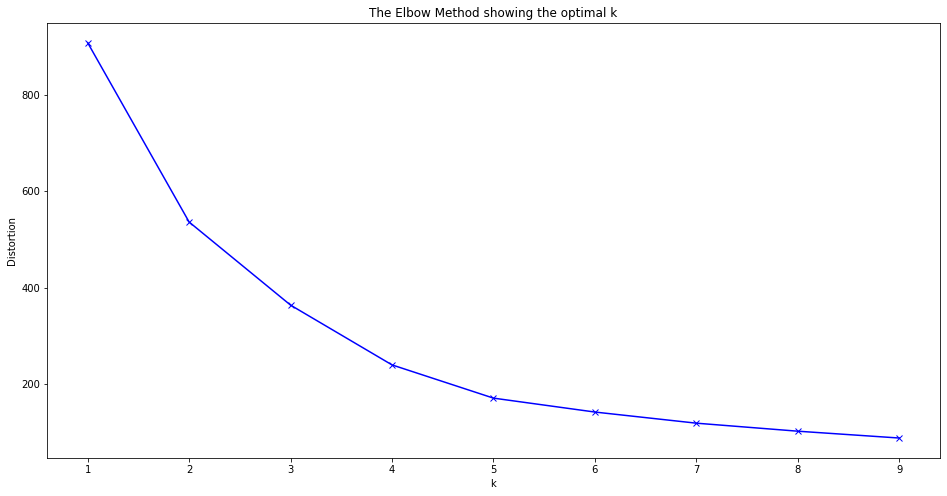

In [ ]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(location)
    distortions.append(kmeanModel.inertia_)
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

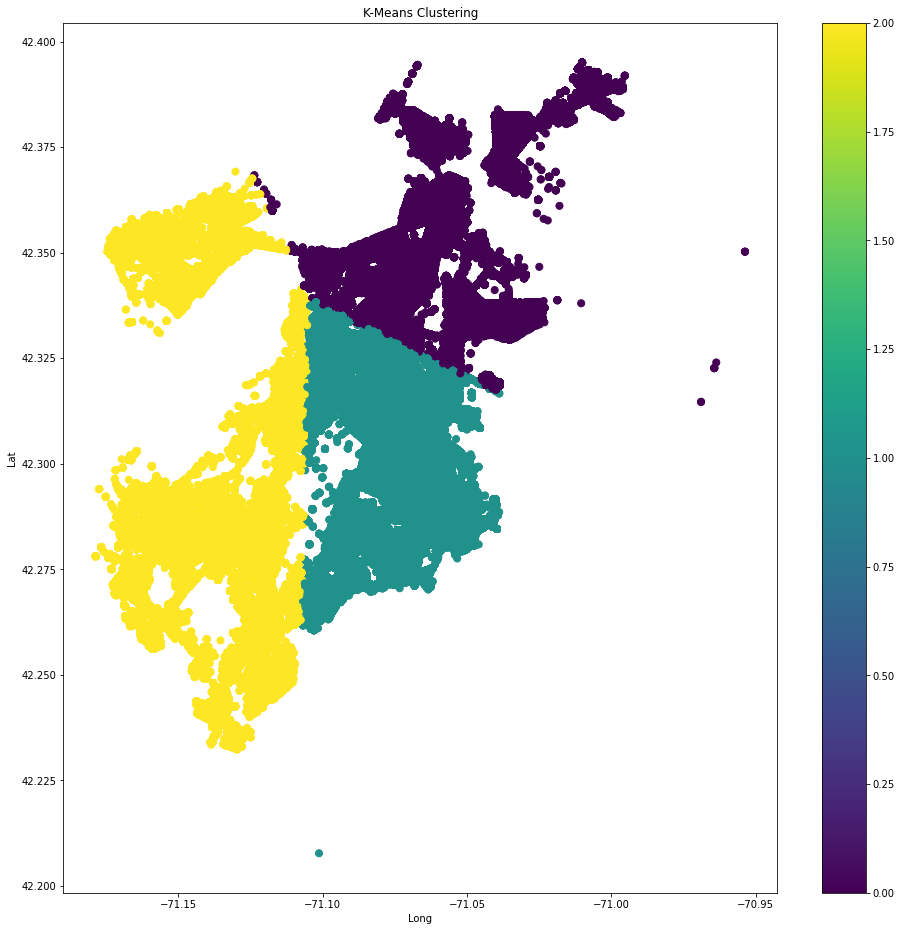

In [ ]:
counter = 0
data = location
noOfClusters = 3

model = KMeans(noOfClusters)
model.fit(data)
clusterLabels = model.predict(data)
centers = model.cluster_centers_
kmeans = pd.DataFrame(clusterLabels)
if (counter == 0):
  data.insert((data.shape[1]) , 'kmeans', kmeans)
  counter += 1

fig = plt.figure(figsize=(16,16))
ax = fig.add_subplot(111)
scatter = ax.scatter(data['Long'],data['Lat'],
                    c=kmeans[0],s=50)
ax.set_title('K-Means Clustering')
ax.set_xlabel('Long')
ax.set_ylabel('Lat')
plt.colorbar(scatter)

In [ ]:
location = dataset_df[['OFFENSE_CODE','OFFENSE_CODE_GROUP']]

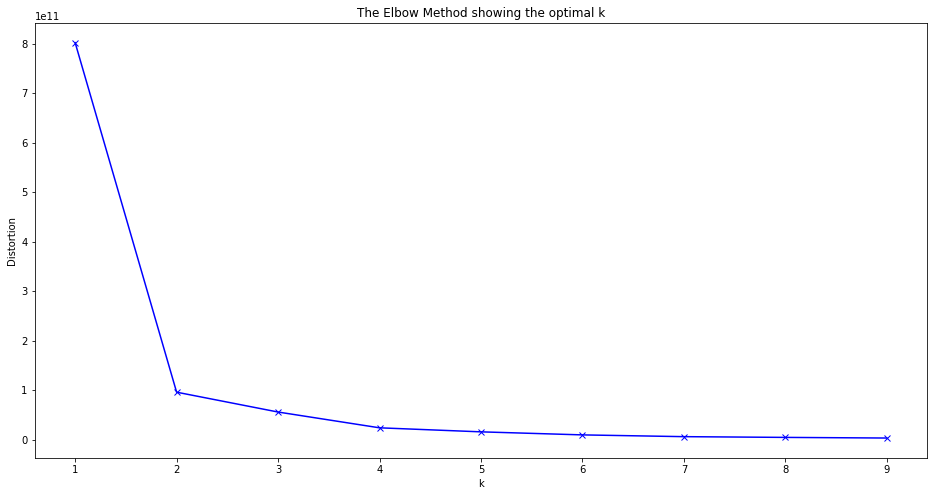

In [ ]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(location)
    distortions.append(kmeanModel.inertia_)
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

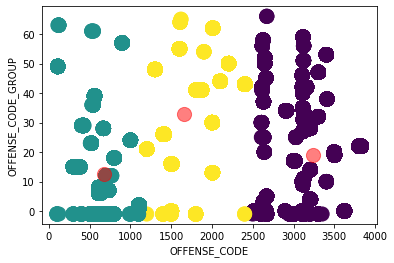

In [ ]:
data = location
noOfClusters = 3

model = KMeans(noOfClusters)
model.fit(data)
clusterLabels = model.predict(data)
centers = model.cluster_centers_
kmeans = pd.DataFrame(clusterLabels)
if (counter == 0):
  data.insert((data.shape[1]) , 'kmeans', kmeans)
  counter += 1

data.plot.scatter(x = 'OFFENSE_CODE', y = 'OFFENSE_CODE_GROUP', c=kmeans, s=200, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.5)

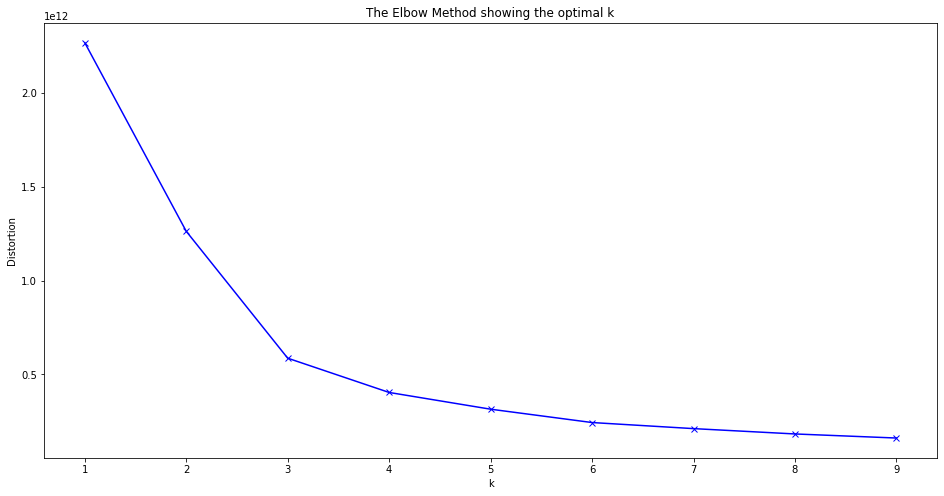

In [ ]:
location = dataset_df[['OFFENSE_CODE','STREET']]

distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(location)
    distortions.append(kmeanModel.inertia_)
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()


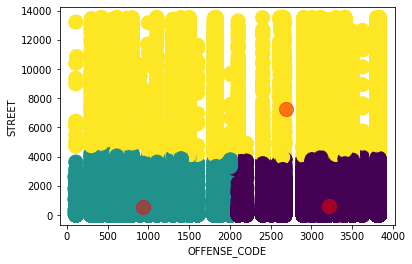

In [ ]:
data = location
noOfClusters = 3

model = KMeans(noOfClusters)
model.fit(data)
clusterLabels = model.predict(data)
centers = model.cluster_centers_
kmeans = pd.DataFrame(clusterLabels)
if (counter == 0):
  data.insert((data.shape[1]) , 'kmeans', kmeans)
  counter += 1

data.plot.scatter(x = 'OFFENSE_CODE', y = 'STREET', c=kmeans, s=200, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.5)


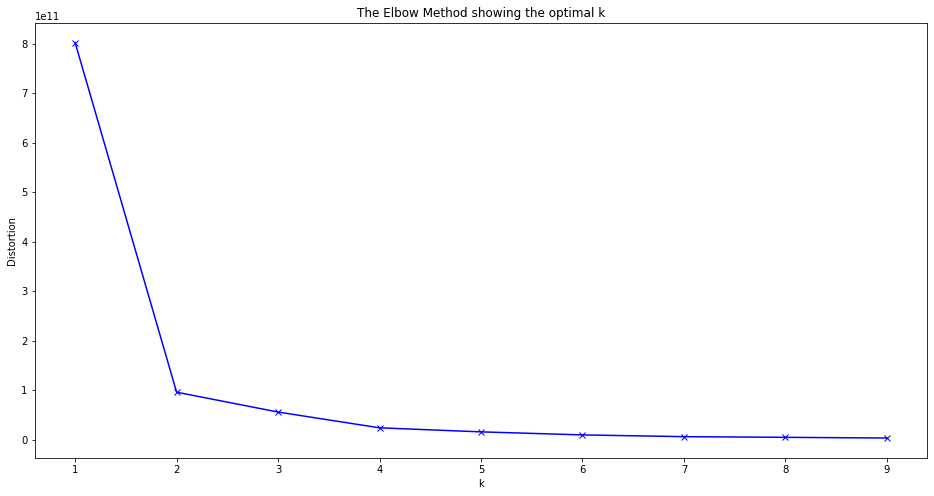

In [ ]:
location = dataset_df[['OFFENSE_CODE','DISTRICT']]

distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(location)
    distortions.append(kmeanModel.inertia_)
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

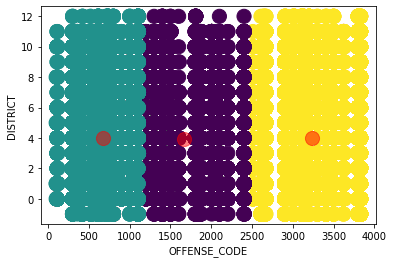

In [ ]:
data = location
noOfClusters = 3

model = KMeans(noOfClusters)
model.fit(data)
clusterLabels = model.predict(data)
centers = model.cluster_centers_
kmeans = pd.DataFrame(clusterLabels)
if (counter == 0):
  data.insert((data.shape[1]) , 'kmeans', kmeans)
  counter += 1

data.plot.scatter(x = 'OFFENSE_CODE', y = 'DISTRICT', c=kmeans, s=200, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.5)


In [ ]:
### Encoding ###

def encoder(df, col):
  unq_col = df[col].unique()

  col_label_index = {} # IMPORTANT
  col_index_label = {} # IMPORTANT
  i = 0
  for d in unq_col:
    if d == 'nan':
      continue
    col_label_index[d] = i
    col_index_label[i] = d
    i += 1

  col_label_index['nan'] = -1
  col_index_label[-1] = 'nan'

  df[col] = df[col].replace(col_label_index)

  return unq_col, col_label_index, col_index_label

## Encode OFFENSE_CODE
unq_oc, oc_label_index, oc_index_label = encoder(dataset_df, 'OFFENSE_CODE')

# REPORTING_AREA
unq_ra, ra_label_index, ra_index_label = encoder(dataset_df, 'REPORTING_AREA')

# SHOOTING
dataset_df['SHOOTING'] = dataset_df['SHOOTING'].astype(str)
unq_sh, sh_label_index, sh_index_label = encoder(dataset_df, 'SHOOTING')

# YEAR
unq_yr, yr_label_index, yr_index_label = encoder(dataset_df, 'YEAR')

# MONTH
unq_mt, mt_label_index, mt_index_label = encoder(dataset_df, 'MONTH')

# HOUR
unq_hr, hr_label_index, hr_index_label = encoder(dataset_df, 'HOUR')

In [ ]:
### Encoding Function ###
def combinedEncoder(df, columns = [], map_list = []):
  # Deep copy
  df_copy = df.copy(True)

  # Update -1s to "unq_val of column - 1"
  # columns = df_copy.columns.to_numpy()
  nan_val_exist_list = [False] * len(columns)
  i = 0
  for c in columns:
    if df_copy[c][df_copy[c] == -1].count() > 0:
      nan_val_exist_list[i] = True
    df_copy[c][df_copy[c] == -1] = df_copy[c].nunique() - 1
    i += 1

  
  # Combined Unique Encoding
  offset = 0
  i = 0
  result_map_list = []
  for c in columns:
    for k in range(len(map_list[i]) - 1):
      if df_copy[c][df_copy[c] == k].count() > 0:
        result_map_list.append(c + '_' + str(map_list[i][k]))       
    if nan_val_exist_list[i]:
      result_map_list.append(c + '_nan')
    df_copy[c] += offset
    offset += df_copy[c].nunique()
    i += 1
  
  return df_copy, result_map_list

In [ ]:
### FP_GROWTH CALLER ###
def apply_FPG(input_df, columns, map_list, minS):
  fp_growth_df, col_val_list = combinedEncoder(input_df, columns, map_list)
  print(len(col_val_list))
  print(col_val_list)
  fp_growth_np = fp_growth_df.to_numpy()
  te = TransactionEncoder()
  te_ary = te.fit(fp_growth_np).transform(fp_growth_np)
  df = pd.DataFrame(te_ary, columns=col_val_list)
  return fpgrowth(df, min_support=minS, use_colnames=True)

In [ ]:
### FP Growth Possible Columns ###
# columns = ['OFFENSE_CODE', 'OFFENSE_CODE_GROUP', 'OFFENSE_DESCRIPTION', 'DISTRICT', 'REPORTING_AREA', 'SHOOTING', 'YEAR', 'MONTH', 'DAY_OF_WEEK', 'HOUR', 'STREET']
# map_list = [oc_index_label, group_index_label, desc_index_label, ds_index_label, ra_index_label, sh_index_label, yr_index_label, mt_index_label, dw_index_label, hr_index_label, st_index_label]
# ds_index_label

In [ ]:
# columns = ['SHOOTING', 'REPORTING_AREA']
# map_list = [desc_index_label, ra_index_label]
# input_df = dataset_df[dataset_df['DISTRICT'] == 0]
# input_df = input_df[columns]

# apply_FPG(input_df, columns, map_list, 0.05)

In [ ]:
# columns = ['OFFENSE_DESCRIPTION', 'STREET']
# map_list = [desc_index_label, st_index_label]
# input_df = dataset_df[columns]

# apply_FPG(input_df, columns, map_list, 0.0005)

In [ ]:
columns = ['YEAR', 'OFFENSE_DESCRIPTION']
map_list = [yr_index_label, desc_index_label]
input_df = dataset_df[columns]

apply_FPG(input_df, columns, map_list, 0.002)

317
['YEAR_2015', 'YEAR_2016', 'YEAR_2017', 'YEAR_2018', 'YEAR_2019', 'YEAR_2020', 'YEAR_2021', 'YEAR_2022', 'OFFENSE_DESCRIPTION_THREATS TO DO BODILY HARM', 'OFFENSE_DESCRIPTION_FRAUD - CREDIT CARD / ATM FRAUD', 'OFFENSE_DESCRIPTION_FRAUD - IMPERSONATION', 'OFFENSE_DESCRIPTION_FRAUD - FALSE PRETENSE / SCHEME', 'OFFENSE_DESCRIPTION_HARASSMENT', 'OFFENSE_DESCRIPTION_PROPERTY - LOST', 'OFFENSE_DESCRIPTION_CRIMINAL HARASSMENT', 'OFFENSE_DESCRIPTION_INTIMIDATING WITNESS', 'OFFENSE_DESCRIPTION_LARCENY ALL OTHERS', 'OFFENSE_DESCRIPTION_RECOVERED - MV RECOVERED IN BOSTON (STOLEN OUTSIDE BOSTON)', 'OFFENSE_DESCRIPTION_LARCENY THEFT OF MV PARTS & ACCESSORIES', 'OFFENSE_DESCRIPTION_INVESTIGATE PERSON', 'OFFENSE_DESCRIPTION_SERVICE TO OTHER PD OUTSIDE OF MA.', 'OFFENSE_DESCRIPTION_FRAUD - WIRE', 'OFFENSE_DESCRIPTION_WARRANT ARREST', 'OFFENSE_DESCRIPTION_AUTO THEFT', 'OFFENSE_DESCRIPTION_VIOL. OF RESTRAINING ORDER W NO ARREST', 'OFFENSE_DESCRIPTION_LARCENY THEFT FROM BUILDING', 'OFFENSE_DESCRIPTIO

,support,itemsets
0,0.094424,(YEAR_2015)
1,0.027291,(OFFENSE_DESCRIPTION_THREATS TO DO BODILY HARM)
2,0.008728,(OFFENSE_DESCRIPTION_FRAUD - CREDIT CARD / ATM...
3,0.005433,(OFFENSE_DESCRIPTION_FRAUD - IMPERSONATION)
4,0.015503,(OFFENSE_DESCRIPTION_FRAUD - FALSE PRETENSE / ...
...,...,...
226,0.003691,(OFFENSE_DESCRIPTION_M/V ACCIDENT - PROPERTY D...
227,0.007463,"(YEAR_2020, OFFENSE_DESCRIPTION_SICK ASSIST)"
228,0.008754,"(OFFENSE_DESCRIPTION_SICK ASSIST, YEAR_2021)"
229,0.002429,"(YEAR_2020, OFFENSE_DESCRIPTION_DRUGS - POSSES..."


In [ ]:
columns = ['DAY_OF_WEEK', 'SHOOTING']
map_list = [dw_index_label, sh_index_label]
input_df = dataset_df[columns]

apply_FPG(input_df, columns, map_list, 0.005)

9
['DAY_OF_WEEK_Friday', 'DAY_OF_WEEK_Thursday', 'DAY_OF_WEEK_Monday', 'DAY_OF_WEEK_Tuesday', 'DAY_OF_WEEK_Sunday', 'DAY_OF_WEEK_Wednesday', 'DAY_OF_WEEK_Saturday', 'SHOOTING_False', 'SHOOTING_True']


,support,itemsets
0,0.992685,(SHOOTING_False)
1,0.152128,(DAY_OF_WEEK_Friday)
2,0.145706,(DAY_OF_WEEK_Thursday)
3,0.143455,(DAY_OF_WEEK_Monday)
4,0.144434,(DAY_OF_WEEK_Tuesday)
5,0.126646,(DAY_OF_WEEK_Sunday)
6,0.146656,(DAY_OF_WEEK_Wednesday)
7,0.140976,(DAY_OF_WEEK_Saturday)
8,0.007315,(SHOOTING_True)
9,0.151134,"(SHOOTING_False, DAY_OF_WEEK_Friday)"
